In [2]:
import os
import pickle

import mediapipe as mp
import cv2
import matplotlib.pyplot as plt


mp_hands = mp.solutions.hands


hands = mp_hands.Hands(static_image_mode=True, min_detection_confidence=0.7 )

DATA_DIR = './data'

data = []
labels = []
for dir_ in os.listdir(DATA_DIR):
    for img_path in os.listdir(os.path.join(DATA_DIR, dir_)):
        data_aux = []

        x_ = []
        y_ = []

        img = cv2.imread(os.path.join(DATA_DIR, dir_, img_path))
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        results = hands.process(img_rgb)
        if results.multi_hand_landmarks:
            for hand_landmarks in results.multi_hand_landmarks:
                for i in range(len(hand_landmarks.landmark)):
                    x = hand_landmarks.landmark[i].x
                    y = hand_landmarks.landmark[i].y

                    x_.append(x)
                    y_.append(y)

                for i in range(len(hand_landmarks.landmark)):
                    x = hand_landmarks.landmark[i].x
                    y = hand_landmarks.landmark[i].y
                    data_aux.append(x - min(x_))
                    data_aux.append(y - min(y_))

            data.append(data_aux)
            labels.append(dir_)

f = open('data.pickle', 'wb')
pickle.dump({'data': data, 'labels': labels}, f)
f.close()

c:\Users\user\AppData\Local\Programs\Python\Python312\Lib\site-packages\google\protobuf\symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


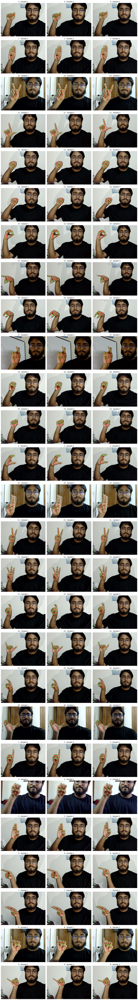

In [ ]:
import os
import cv2
import mediapipe as mp
import matplotlib.pyplot as plt
import numpy as np

def visualize_hand_landmarks_detailed(data_dir, num_samples=3):
    """
    Visualize hand landmarks with custom styling for better visibility.
    """
    mp_hands = mp.solutions.hands
    mp_drawing = mp.solutions.drawing_utils
    
    hands = mp_hands.Hands(static_image_mode=True, min_detection_confidence=0.7)
    
    classes = sorted(os.listdir(data_dir))
    rows = len(classes)
    cols = num_samples
    
    plt.figure(figsize=(15, 4*rows))
    
    # Custom drawing specs
    landmark_spec = mp_drawing.DrawingSpec(
        color=(0, 255, 0),  # Green color for landmarks
        thickness=2,
        circle_radius=2
    )
    connection_spec = mp_drawing.DrawingSpec(
        color=(255, 0, 0),  # Red color for connections
        thickness=2
    )
    
    for class_idx, class_name in enumerate(classes):
        class_dir = os.path.join(data_dir, class_name)
        image_files = sorted(os.listdir(class_dir))[:num_samples]
        
        for img_idx, img_file in enumerate(image_files):
            img_path = os.path.join(class_dir, img_file)
            img = cv2.imread(img_path)
            img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            
            # Create a copy for drawing
            annotated_image = img_rgb.copy()
            
            results = hands.process(img_rgb)
            
            if results.multi_hand_landmarks:
                for hand_landmarks in results.multi_hand_landmarks:
                    mp_drawing.draw_landmarks(
                        image=annotated_image,
                        landmark_list=hand_landmarks,
                        connections=mp_hands.HAND_CONNECTIONS,
                        landmark_drawing_spec=landmark_spec,
                        connection_drawing_spec=connection_spec
                    )
            
            plt.subplot(rows, cols, class_idx * cols + img_idx + 1)
            plt.imshow(annotated_image)
            plt.title(f'{class_name} - Sample {img_idx+1}')
            plt.axis('off')
    
    plt.tight_layout()
    plt.show()


visualize_hand_landmarks_detailed('./data', num_samples=3)